Code for **super-resolution** (figures $1$ and $5$ from main paper).. Change `factor` to $8$ to reproduce images from fig. $9$ from supmat.

You can play with parameters and see how they affect the result. 

# Import libs

In [22]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models import *

import torch
import torch.optim

from skimage.measure import compare_psnr
from models.downsampler import Downsampler

from utils.sr_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize = -1 
factor = 4 # 8
enforse_div32 = 'CROP' # we usually need the dimensions to be divisible by a power of two (32 in this case)
PLOT = True

# To produce images from the paper we took *_GT.png images from LapSRN viewer for corresponding factor,
# e.g. x4/zebra_GT.png for factor=4, and x8/zebra_GT.png for factor=8 
path_to_image = 'data/sr/zebra_GT.png'
#path_to_image = 'data/bayesian/BACTERIA-1351146-0006.jpg'
n_channels = 3

# Load image and baselines

HR and LR resolutions: (576, 384), (144, 96)


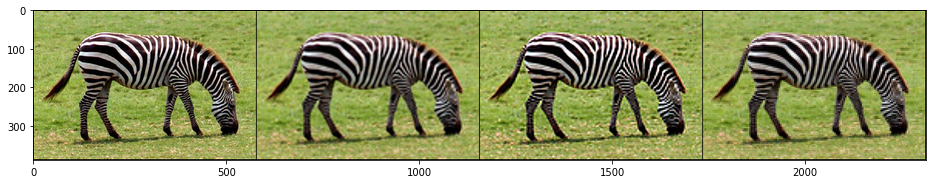

PSNR bicubic: 23.1048   PSNR nearest: 20.8212


/home/laves/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  if __name__ == '__main__':
/home/laves/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  # Remove the CWD from sys.path while we load stuff.


In [23]:
# Starts here
imgs = load_LR_HR_imgs_sr(path_to_image , imsize, factor, enforse_div32)

imgs['bicubic_np'], imgs['sharp_np'], imgs['nearest_np'] = get_baselines(imgs['LR_pil'], imgs['HR_pil'])

if PLOT:
    plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['sharp_np'], imgs['nearest_np']], 4,12);
    print ('PSNR bicubic: %.4f   PSNR nearest: %.4f' %  (
                                        compare_psnr(imgs['HR_np'], imgs['bicubic_np']), 
                                        compare_psnr(imgs['HR_np'], imgs['nearest_np'])))

# Set up parameters and net

In [24]:
input_depth = 32
 
INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

LR = 0.05
tv_weight = 0.0

OPTIMIZER = 'adam'

if factor == 4: 
    num_iter = 10000
    reg_noise_std = 0.03
elif factor == 8:
    num_iter = 4000
    reg_noise_std = 0.05
else:
    assert False, 'We did not experiment with other factors'

In [25]:
net_input = get_noise(input_depth, INPUT, (imgs['HR_pil'].size[1], imgs['HR_pil'].size[0])).type(dtype).detach()

NET_TYPE = 'skip' # UNet, ResNet
net = get_net(input_depth, 'skip', pad,
              skip_n33d=128, 
              skip_n33u=128, 
              skip_n11=4, 
              num_scales=5,
              n_channels=n_channels,
              need_sigmoid=True,
              upsample_mode='bilinear').type(dtype)

# Losses
mse = torch.nn.MSELoss().type(dtype)

img_LR_var = np_to_torch(imgs['LR_np']).type(dtype)

downsampler = Downsampler(n_planes=n_channels, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True).type(dtype)

#ds_params = [p for p in downsampler.parameters() if len(p.size()) == 4]

# Define closure and optimize

In [26]:
def closure(_loss='mse'):
    global i, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

    out_HR = net(net_input)
    if out_HR.size()[1] == 4:
        out_HR[:,:-1] = torch.sigmoid(out_HR[:,:-1])
    out_LR = downsampler(out_HR)
    
    if _loss == 'mse':
        total_loss = mse(out_LR, img_LR_var) 
    else:
        total_loss = nll(out_LR, img_LR_var)
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
    psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR)[:3])
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR)[:3])
    print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
                      
    # History
    psnr_history.append([psnr_LR, psnr_HR])
    
    if PLOT and i % 500 == 0:
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], np.clip(out_HR_np, 0, 1)[:3]], factor=13, nrow=3)

    i += 1
    
    return total_loss

/home/laves/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/home/laves/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.


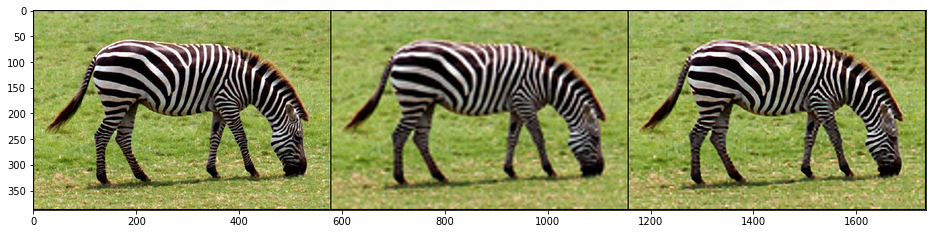

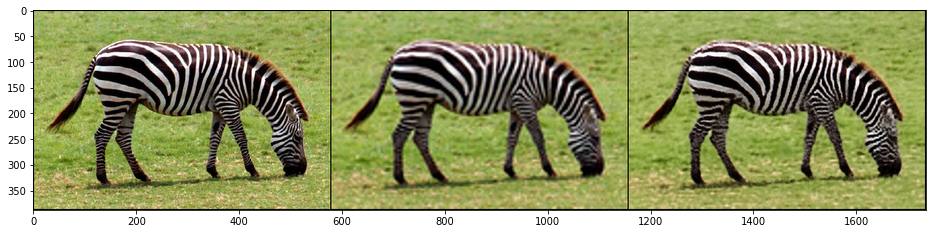

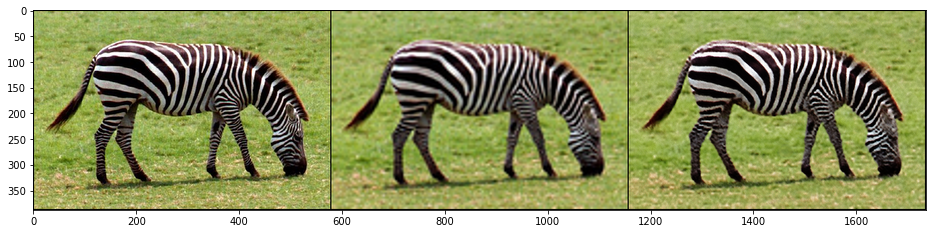

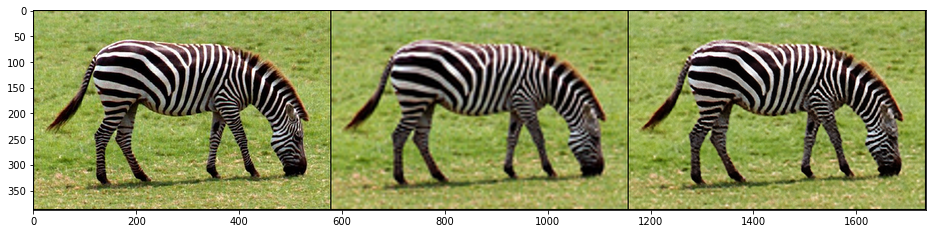

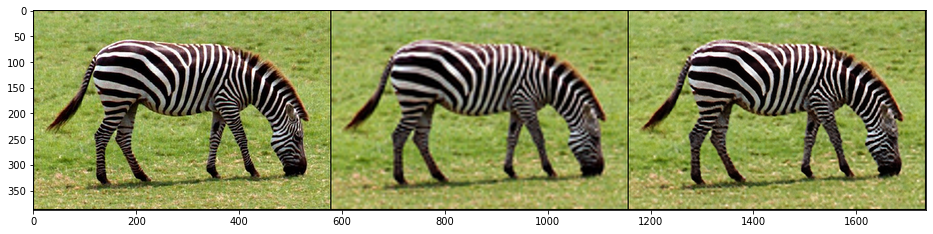

...

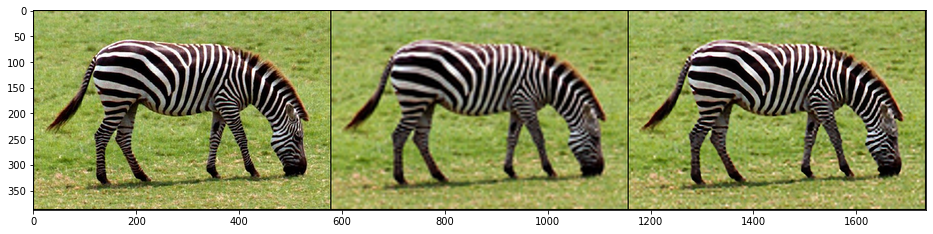

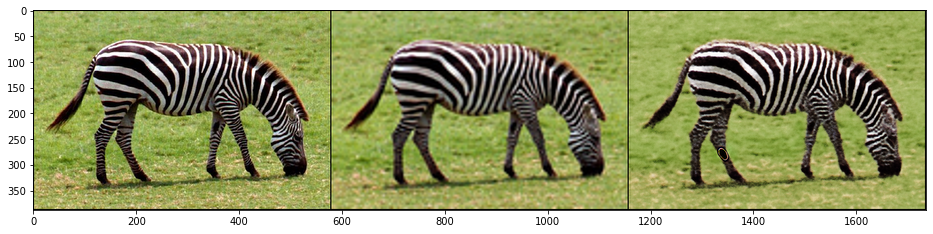

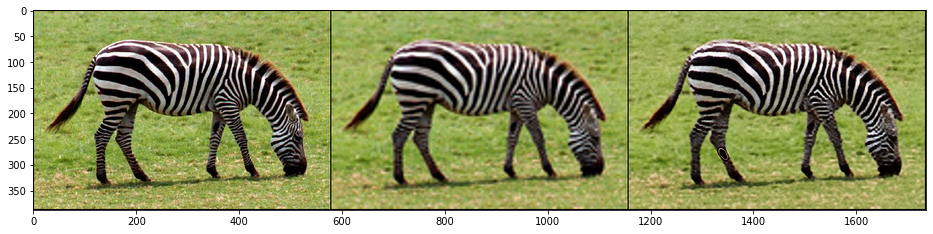

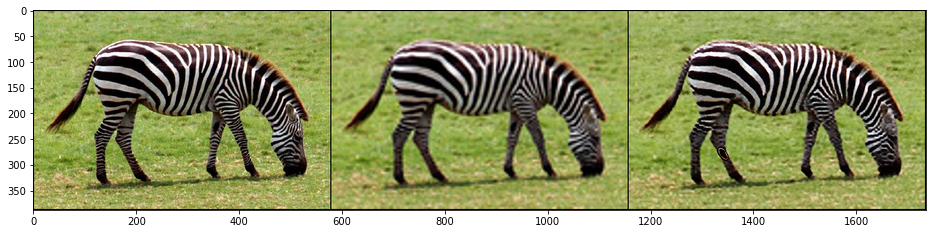

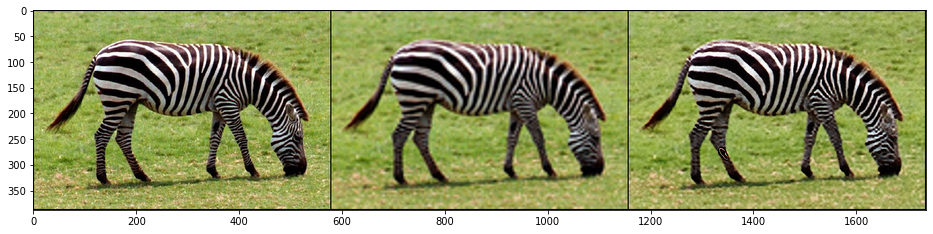

In [ ]:
psnr_history = [] 
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

weight_decay = 3e-4

i = 0
p = get_params(OPT_OVER, net, net_input)
#optimize(OPTIMIZER, p, closure, LR, num_iter, weight_decay=weight_decay)

optimizer = torch.optim.Adam(p, lr=LR)

for j in range(num_iter):
    optimizer.zero_grad()
    closure()
    optimizer.step()

psnr_history_dip = psnr_history
plt.plot(range(len(psnr_history)), psnr_history)
plt.show()

In [ ]:
psnr_history = [] 
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

weight_decay = 3e-4
LR_DS = 1e-6
wd_ds = 3e-8

i = 0
#optimize(OPTIMIZER, p, closure, LR, num_iter, weight_decay=weight_decay)
net = get_net(input_depth, 'skip', pad,
              skip_n33d=128, 
              skip_n33u=128, 
              skip_n11=4, 
              num_scales=5,
              need_sigmoid=True,
              upsample_mode='bilinear').type(dtype)

downsampler = Downsampler(n_planes=3, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True).type(dtype)

net_params = get_params(OPT_OVER, net, net_input)
ds_params = [p for p in downsampler.parameters() if len(p.size()) == 4]

optimizer_net = torch.optim.Adam(net_params, lr=LR, weight_decay=weight_decay)
optimizer_ds = torch.optim.Adam(ds_params, lr=LR_DS, weight_decay=wd_ds)

for i in range(num_iter):
    optimizer_net.zero_grad()
    downsampler.eval()
    net.train()
    
    loss_dip = closure()
    
    #loss_dip.backward()
    optimizer_net.step()
    
    #if i > 500:
    optimizer_ds.zero_grad()
    downsampler.train()
    net.eval()

    out_HR = net(net_input)
    out_LR = downsampler(out_HR)

    ds_loss = mse(out_LR, img_LR_var) 

    ds_loss.backward()
    optimizer_ds.step()

psnr_history_ds = psnr_history

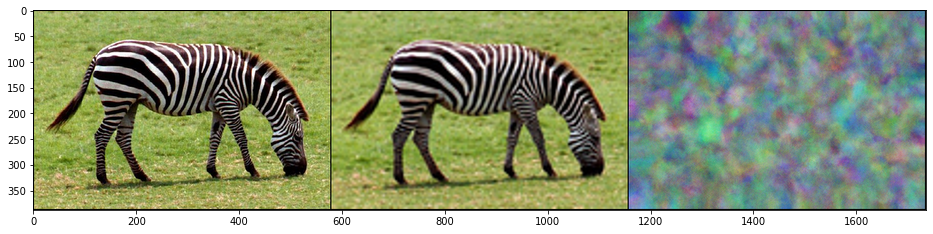

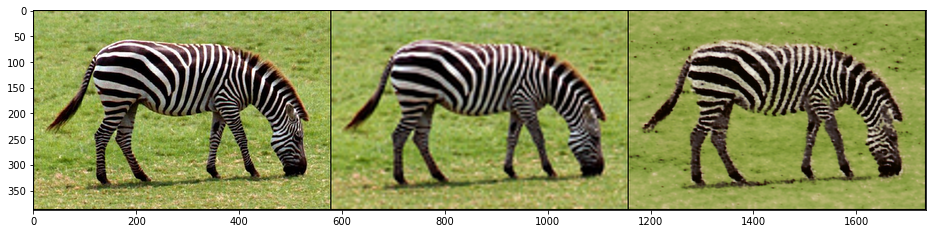

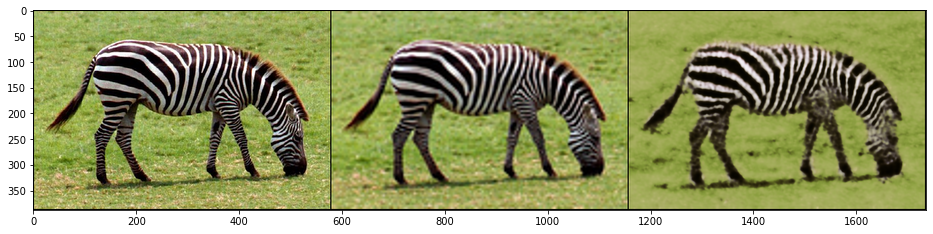

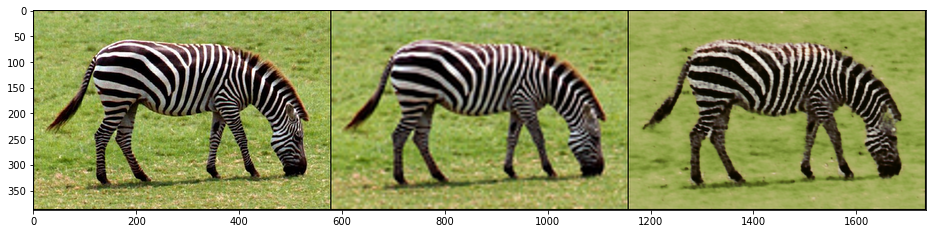

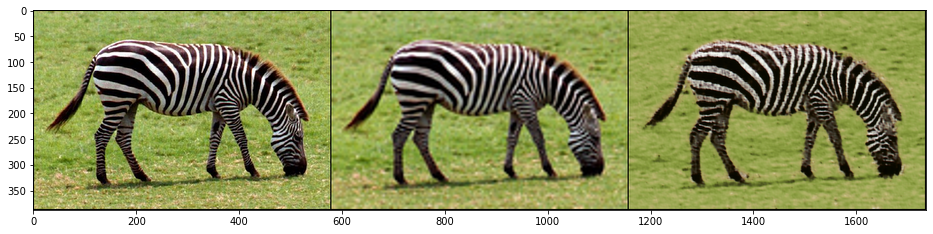

...

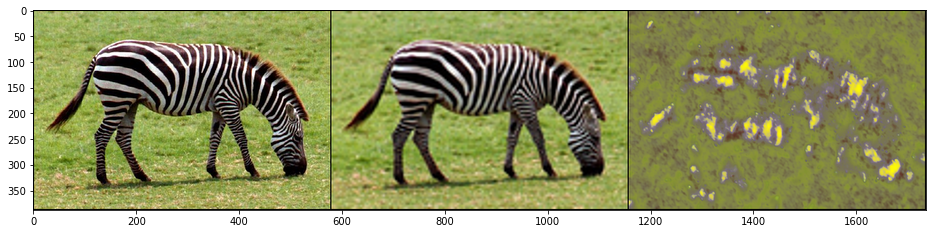

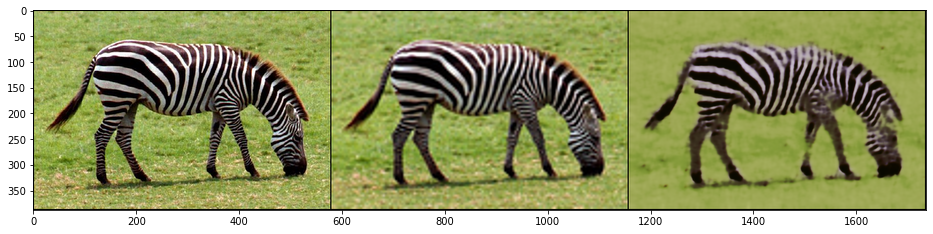

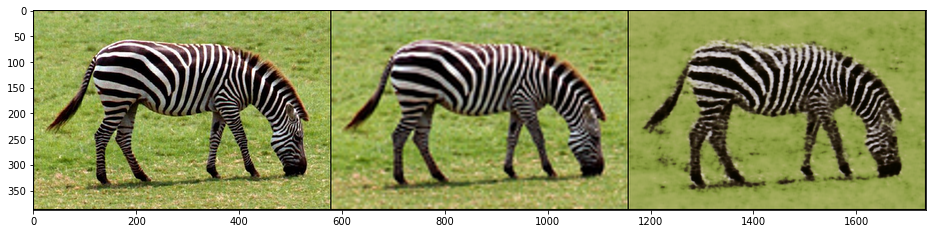

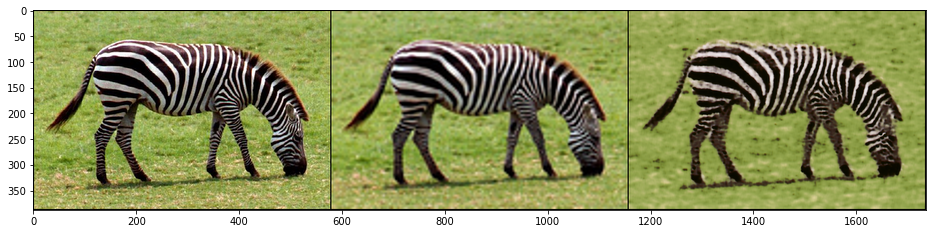

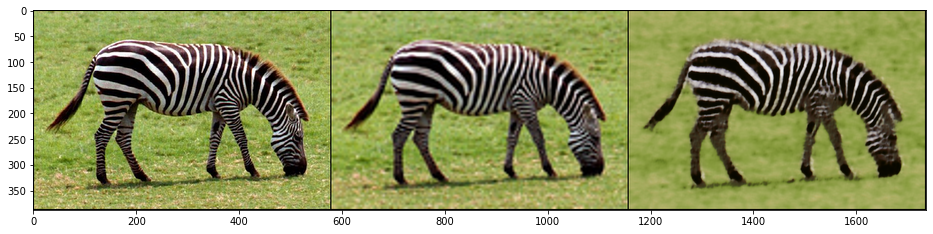

In [13]:
import sys
sys.path.append('..')

from BayTorch import MeanFieldVI, MCDropoutVI
from BayTorch.inference.losses import NLLLoss2d

psnr_history = [] 
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

weight_decay = 3e-4
LR_DS = 1e-6

i = 0
#optimize(OPTIMIZER, p, closure, LR, num_iter, weight_decay=weight_decay)
net = get_net(input_depth, 'skip', pad,
              skip_n33d=128, 
              skip_n33u=128, 
              skip_n11=4, 
              num_scales=5,
              n_channels=4,
              upsample_mode='bilinear').type(dtype)

dropout_type = '2d'
dropout_p = 0.1
net = MCDropoutVI(net, dropout_type=dropout_type, dropout_p=dropout_p)

nll = NLLLoss2d()

downsampler = Downsampler(n_planes=4, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True).type(dtype)
downsampler = MCDropoutVI(downsampler, dropout_type='1d', dropout_p=0.05)

net_params = get_params(OPT_OVER, net, net_input)
ds_params = [p for p in downsampler.parameters() if len(p.size()) == 4]

optimizer_net = torch.optim.Adam(net_params, lr=LR, weight_decay=weight_decay)
optimizer_ds = torch.optim.Adam(ds_params, lr=LR_DS)

for i in range(num_iter):
    optimizer_net.zero_grad()
    downsampler.eval()
    net.train()
    
    loss_dip = closure(_loss='nll')
    
    #loss_dip.backward()
    optimizer_net.step()
    
    #if i > 500:
    optimizer_ds.zero_grad()
    downsampler.train()
    net.eval()

    out_HR = net(net_input)
    out_LR = downsampler(out_HR)

    ds_loss = nll(out_LR, img_LR_var) 

    ds_loss.backward()
    optimizer_ds.step()

psnr_history_mc = psnr_history

torch.Size([1, 3, 384, 576])
15.165217945155625


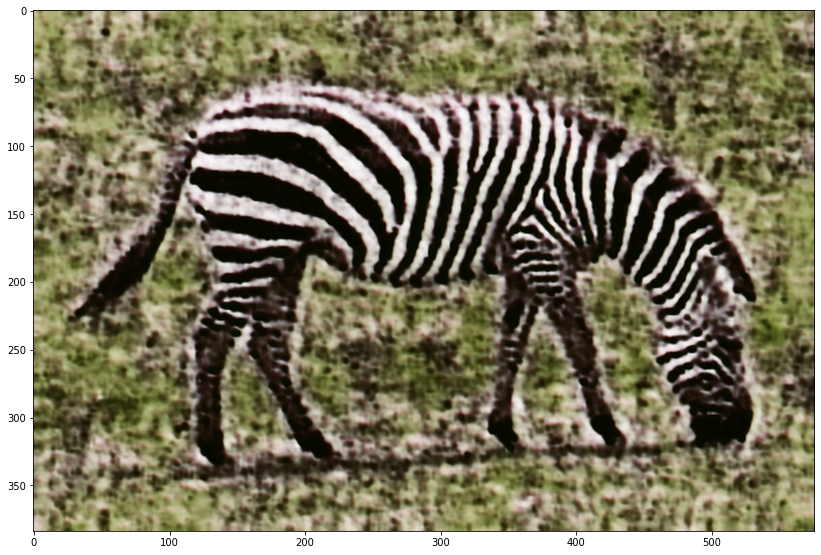

In [14]:
img_list = []

with torch.no_grad():
    for _ in range(100):
        out_HR = net(net_input)
        out_HR[:,:-1] = torch.sigmoid(out_HR[:,:-1])
        out_HR[:,-1] = -torch.exp(out_HR[:,-1])
        img_list.append(out_HR)

outs = torch.cat(img_list, dim=0)
out_mean_HR = torch.mean(outs, dim=0)[:-1].unsqueeze(0)
print(out_mean_HR.shape)
psnr = compare_psnr(imgs['HR_np'], torch_to_np(out_mean_HR))
print(psnr)

_ = plot_image_grid([torch_to_np(out_mean_HR)], factor=13)

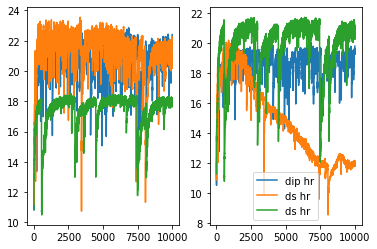

In [15]:
psnr_history_dip= np.array(psnr_history_dip)
psnr_history_ds = np.array(psnr_history_ds)
psnr_history_mc = np.array(psnr_history_mc)

fig, (ax_lr, ax_hr) = plt.subplots(1,2)
ax_lr.plot(range(num_iter), psnr_history_dip[:,0], label='dip lr')
ax_lr.plot(range(num_iter), psnr_history_ds[:,0], label='ds lr')
ax_lr.plot(range(num_iter), psnr_history_mc[:,0], label='ds lr')
ax_hr.plot(range(num_iter), psnr_history_dip[:,1], label='dip hr')
ax_hr.plot(range(num_iter), psnr_history_ds[:,1], label='ds hr')
ax_hr.plot(range(num_iter), psnr_history_mc[:,1], label='ds hr')
plt.legend()
plt.show()

(4, 384, 576)


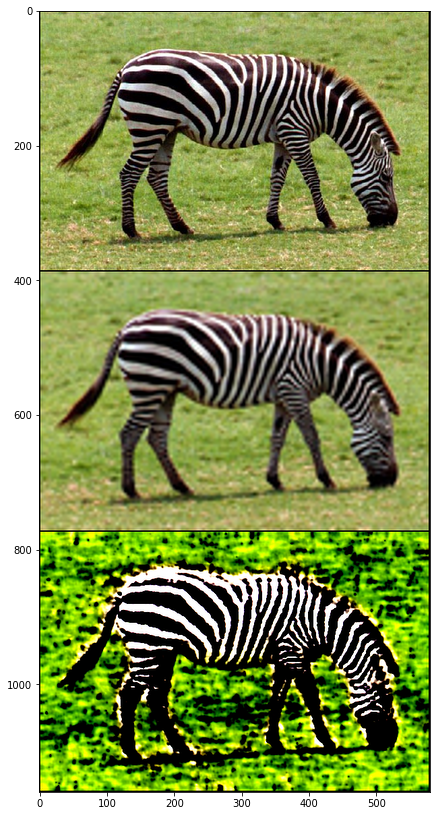

In [16]:
out_HR_np = np.clip(torch_to_np(net(net_input)), 0, 1)
print(out_HR_np.shape)
#result_deep_prior = put_in_center(out_HR_np, imgs['orig_np'].shape[1:])

# For the paper we acually took `_bicubic.png` files from LapSRN viewer and used `result_deep_prior` as our result
plot_image_grid([imgs['HR_np'],
                 imgs['bicubic_np'],
                 out_HR_np[:3]], factor=4, nrow=1);